# Analysis of NYC voting data for the 2025 Mayoral Democratic Primary 

### Data sources
* [Election Districts](https://www.nyc.gov/content/planning/pages/resources/datasets/election-districts)
* [Congressional Districts](https://www.nyc.gov/content/planning/pages/resources/datasets/congressional-districts)
* [Voting Data](https://vote.nyc/page/election-results-summary)

In [1]:
import geopandas as gpd
import pandas as pd
import folium
import sys
import os
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [2]:
repo_path = os.path.split(os.getcwd())[0]

sys.path.insert(0, repo_path + "/src")
sys.path.insert(0, repo_path + "/data")

## Combine Geo files and de-duplicate

In [3]:
# read in shape files
gdfa = gpd.read_file(repo_path + "/data/nyed_25b/nyed.shp")
gdfc = gpd.read_file(repo_path + "/data/nycg_25b/nycg.shp")

In [4]:
# join geo files
udf = gdfc.overlay(gdfa, how="union")

In [5]:
intdf = gpd.sjoin(udf, gdfc, how="left")
intdf.shape

(7165, 11)

In [6]:
intdf = intdf[["CongDist_left", "ElectDist", "geometry"]]
intdf.columns = ["cong_dist", "precinct_id", "geometry"]
intdf.columns

Index(['cong_dist', 'precinct_id', 'geometry'], dtype='object')

In [7]:
intdf = intdf.dissolve(by=["cong_dist", "precinct_id"], aggfunc='first').reset_index()
intdf["geometry"] = intdf.normalize()
intdf = intdf.drop_duplicates()
dist = intdf[["cong_dist", "precinct_id"]]
dist = dist.groupby("precinct_id")["cong_dist"].agg("first").reset_index()

In [8]:
dist.shape, intdf.shape

((4264, 2), (4764, 3))

## Merge Vote Data with Election Districts & Reshape

In [9]:
# read in voting data
vdf = pd.read_csv(repo_path + "/data/votes.csv")

In [10]:
# create standardized precint id, which is a concatenation of Assembly District id and Election District id
# the `ElectDist` field in the geo files is already in the format but needs to be converted to a string

dist["precinct_id"] = dist["precinct_id"].map(lambda x: str(round(x)))

vdf["ad_id"] = vdf["AD"].map(lambda x: x.split("-")[0].replace("AD", ""))
vdf["ed_id"] = vdf["election_district"].map(lambda x: x.replace("ED ", "").zfill(3))
vdf["precinct_id"] = vdf[["ad_id", "ed_id"]].apply(lambda row: ''.join(row.values.astype(str)), axis=1)

In [11]:
# merge voting data and geo ids without geometry
votes = pd.merge(vdf, dist, how="left", on="precinct_id")

In [12]:
votes.head()

,AD,election_district,pct_reported,zohran_kwame_mamdani,scott_m_stringer,selma_k_bartholomew,zellnor_myrie,adrienne_e_adams,andrew_m_cuomo,jessica_ramos,whitney_r_tilson,michael_blake,brad_lander,paperboy_love_prince,write_in,ad_id,ed_id,precinct_id,cong_dist
0,AD37-1,ED 71,80.0,0,0,0,0,0,0,0,0,0,0,0,0,37,071,37071,7.0
1,AD61-1,ED 60,99.0,141,6,0,5,11,75,1,3,0,53,0,1,61,060,61060,10.0
2,AD61-1,ED 61,99.0,148,9,0,6,11,175,4,16,1,70,0,0,61,061,61061,10.0
3,AD61-1,ED 62,99.0,106,14,0,3,6,141,1,5,1,64,0,1,61,062,61062,10.0
4,AD61-1,ED 63,99.0,118,20,0,7,10,166,0,13,1,71,0,0,61,063,61063,10.0


## Add additional columns

In [13]:
candidates = ["zohran_kwame_mamdani", "scott_m_stringer", "selma_k_bartholomew", "zellnor_myrie",
              "adrienne_e_adams", "andrew_m_cuomo", "jessica_ramos", "whitney_r_tilson",
              "michael_blake", "brad_lander", "paperboy_love_prince", "write_in"]

top_candidates = ["zohran_kwame_mamdani", "brad_lander", "andrew_m_cuomo"]
else_candidates = [c for c in candidates if c not in top_candidates]
progressive_candidates = ["zohran_kwame_mamdani", "brad_lander"]


votes["total"] = votes[candidates].apply(lambda row: sum(row), axis=1)
votes["progressive"] = votes[progressive_candidates].apply(lambda row: sum(row), axis=1)
votes["else"] = votes[else_candidates].apply(lambda row: sum(row), axis=1)

In [14]:
votes[candidates + ["total", "progressive", "else"]].sum().sort_values(ascending=False)

total                   993546
progressive             544654
zohran_kwame_mamdani    432305
andrew_m_cuomo          361840
brad_lander             112349
else                     87052
adrienne_e_adams         40953
scott_m_stringer         16387
zellnor_myrie             9870
whitney_r_tilson          7828
michael_blake             3992
jessica_ramos             3862
paperboy_love_prince      1417
write_in                  1415
selma_k_bartholomew       1328
dtype: int64

## Recombine Geo data

In [15]:
gdfa.columns

Index(['ElectDist', 'Shape_Leng', 'Shape_Area', 'geometry'], dtype='object')

In [16]:
votes.columns

Index(['AD', 'election_district', 'pct_reported', 'zohran_kwame_mamdani',
       'scott_m_stringer', 'selma_k_bartholomew', 'zellnor_myrie',
       'adrienne_e_adams', 'andrew_m_cuomo', 'jessica_ramos',
       'whitney_r_tilson', 'michael_blake', 'brad_lander',
       'paperboy_love_prince', 'write_in', 'ad_id', 'ed_id', 'precinct_id',
       'cong_dist', 'total', 'progressive', 'else'],
      dtype='object')

In [17]:
dist.columns

Index(['precinct_id', 'cong_dist'], dtype='object')

In [18]:
votes_ge = pd.merge(dist, votes, how="left", on="precinct_id")

In [19]:
votes_ge.columns

Index(['precinct_id', 'cong_dist_x', 'AD', 'election_district', 'pct_reported',
       'zohran_kwame_mamdani', 'scott_m_stringer', 'selma_k_bartholomew',
       'zellnor_myrie', 'adrienne_e_adams', 'andrew_m_cuomo', 'jessica_ramos',
       'whitney_r_tilson', 'michael_blake', 'brad_lander',
       'paperboy_love_prince', 'write_in', 'ad_id', 'ed_id', 'cong_dist_y',
       'total', 'progressive', 'else'],
      dtype='object')

In [20]:
votes_ge.shape

(4264, 23)

In [21]:
votes_ge.head()

,precinct_id,cong_dist_x,AD,election_district,pct_reported,zohran_kwame_mamdani,scott_m_stringer,selma_k_bartholomew,zellnor_myrie,adrienne_e_adams,...,michael_blake,brad_lander,paperboy_love_prince,write_in,ad_id,ed_id,cong_dist_y,total,progressive,else
0,23001,5.0,AD23-4,ED 1,99.0,31,7,0,1,0,...,3,23,7,1,23,001,5.0,198,54,23
1,23002,5.0,AD23-4,ED 2,99.0,25,6,1,0,6,...,1,14,1,1,23,002,5.0,168,39,21
2,23003,5.0,AD23-4,ED 3,99.0,10,3,0,0,2,...,0,5,0,1,23,003,5.0,49,15,9
3,23004,5.0,AD23-4,ED 4,75.0,42,8,0,1,3,...,1,25,3,0,23,004,5.0,244,67,19
4,23005,5.0,AD23-4,ED 5,75.0,37,7,0,0,0,...,1,32,3,1,23,005,5.0,258,69,19


In [22]:
votes_ge[candidates].sum()

zohran_kwame_mamdani    432305
scott_m_stringer         16387
selma_k_bartholomew       1328
zellnor_myrie             9870
adrienne_e_adams         40953
andrew_m_cuomo          361840
jessica_ramos             3862
whitney_r_tilson          7828
michael_blake             3992
brad_lander             112349
paperboy_love_prince      1417
write_in                  1415
dtype: int64

In [23]:
votes_ge = votes_ge[["precinct_id", "cong_dist_x", "total", "progressive", "else"] + candidates]
votes_ge.columns = ["precinct_id", "cong_dist"] + list(votes_ge.columns)[2:]

In [24]:
for col in "cong_dist", "precinct_id":
    votes_ge[col] = [str(round(int(x))) for x in votes_ge[col]]

In [25]:
votes_ge.head()

,precinct_id,cong_dist,total,progressive,else,zohran_kwame_mamdani,scott_m_stringer,selma_k_bartholomew,zellnor_myrie,adrienne_e_adams,andrew_m_cuomo,jessica_ramos,whitney_r_tilson,michael_blake,brad_lander,paperboy_love_prince,write_in
0,23001,5,198,54,23,31,7,0,1,0,121,0,4,3,23,7,1
1,23002,5,168,39,21,25,6,1,0,6,108,0,5,1,14,1,1
2,23003,5,49,15,9,10,3,0,0,2,25,1,2,0,5,0,1
3,23004,5,244,67,19,42,8,0,1,3,158,0,3,1,25,3,0
4,23005,5,258,69,19,37,7,0,0,0,170,1,6,1,32,3,1


## Plot some maps

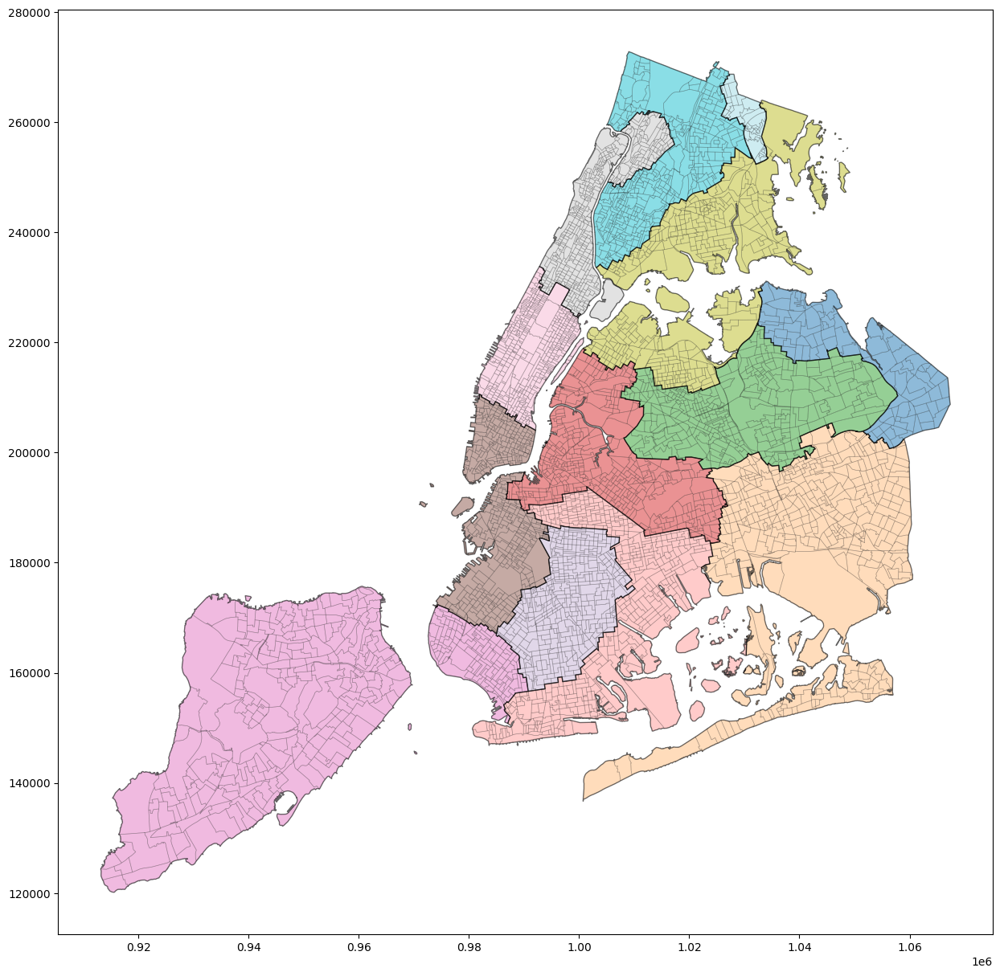

In [26]:
cdf = intdf.plot(figsize=(15,15), column="cong_dist", cmap="tab20", alpha=0.5)
intdf.plot(ax=cdf, color="none", edgecolor='black', alpha=0.2, linewidth=0.5)
gdfc.plot(ax=cdf, color="none", edgecolor='black', alpha=0.5)
plt.show()

In [27]:
for col in "cong_dist", "precinct_id":
    intdf[col] = [str(round(int(x))) for x in intdf[col]]

In [28]:
for df in intdf, votes_ge:
    df["precinct_cong"] = df.apply(lambda x: "_".join([x.precinct_id, x.cong_dist]), axis=1)

In [29]:
geo = pd.merge(intdf, votes_ge, how="left", on="precinct_cong")

In [30]:
geo.head()

,cong_dist_x,precinct_id_x,geometry,precinct_cong,precinct_id_y,cong_dist_y,total,progressive,else,zohran_kwame_mamdani,...,selma_k_bartholomew,zellnor_myrie,adrienne_e_adams,andrew_m_cuomo,jessica_ramos,whitney_r_tilson,michael_blake,brad_lander,paperboy_love_prince,write_in
0,3,24055,"POLYGON ((1051666.284 203797.155, 1051671.684 ...",24055_3,24055,3,156.0,65.0,11.0,60.0,...,0.0,0.0,7.0,80.0,1.0,0.0,0.0,5.0,0.0,1.0
1,3,24056,"POLYGON ((1054440.415 206277.869, 1054476.16 2...",24056_3,24056,3,235.0,102.0,17.0,87.0,...,0.0,0.0,12.0,116.0,0.0,1.0,0.0,15.0,0.0,0.0
2,3,24057,"POLYGON ((1055205.741 205440.437, 1055220.21 2...",24057_3,24057,3,188.0,94.0,22.0,89.0,...,0.0,0.0,11.0,72.0,1.0,1.0,1.0,5.0,0.0,1.0
3,3,24058,"POLYGON ((1052810.209 204598.899, 1052925.819 ...",24058_3,24058,3,281.0,111.0,20.0,72.0,...,0.0,0.0,13.0,150.0,1.0,1.0,0.0,39.0,0.0,0.0
4,3,26001,"POLYGON ((1059574.334 206466.159, 1059605.09 2...",26001_3,26001,3,108.0,77.0,6.0,72.0,...,0.0,0.0,4.0,25.0,1.0,0.0,0.0,5.0,1.0,0.0


In [31]:
geo.shape

(4764, 21)

## Get Congressional District Info

In [32]:
import requests
import bs4

In [33]:
# pull data from the cook political report by scraping ballotpedia
url ="https://ballotpedia.org/The_Cook_Political_Report%27s_Partisan_Voter_Index"
req = requests.get(url)
req.status_code

200

In [34]:
soup = bs4.BeautifulSoup(req.text, 'html.parser')

In [35]:
print('Classes of each table:')
for table in soup.find_all('table'):
    print(table.get('id'))

Classes of each table:
None
None
None
dt-0242e256
dt-5d1831d9
dt-85f24a87
dt-826ad001
dt-317a7ebd
None
None


In [36]:
table_id = "dt-0242e256"
table = soup.find('table', id=table_id)

In [37]:
# Collecting Ddata
for row in table.tbody.find_all('tr'):    
    # Find all data for each column
    columns = row.find_all('td')
    # print(columns)

In [38]:
# Defining of the dataframe
df = pd.DataFrame(columns=['district', 'incumbent', 'pvi'])

# Collecting Ddata
for row in table.tbody.find_all('tr'):    
    # Find all data for each column
    columns = row.find_all('td')
    
    if(columns != []):
        district = columns[0].text.strip()
        incumbent = columns[1].text.strip()
        pvi = columns[2].text.strip()

        new_row = pd.DataFrame({'district': district,  'incumbent': incumbent, 'pvi': pvi}, index=[0])

        df = pd.concat([df, new_row], ignore_index=True)

In [39]:
df.head()

,district,incumbent,pvi
0,Alaska's At-Large,Nick Begich,R+6
1,Alabama's 1st,Barry Moore,R+27
2,Alabama's 2nd,Shomari Figures,D+5
3,Alabama's 3rd,Mike Rogers,R+23
4,Alabama's 4th,Robert Aderholt,R+33


In [40]:
df["state"] = df["district"].map(lambda x: x.split("'")[0])
df["cong_dist"] = df["district"].map(lambda x: x.split("'")[1].strip("s "))

In [41]:
dfny = df[df.state == "New York"]
dfny

,district,incumbent,pvi,state,cong_dist
272,New York's 1st,Nick LaLota,R+4,New York,1st
273,New York's 2nd,Andrew Garbarino,R+6,New York,2nd
274,New York's 3rd,Tom Suozzi,EVEN,New York,3rd
275,New York's 4th,Laura Gillen,D+2,New York,4th
276,New York's 5th,Gregory Meeks,D+24,New York,5th
277,New York's 6th,Grace Meng,D+6,New York,6th
278,New York's 7th,Nydia Velázquez,D+25,New York,7th
279,New York's 8th,Hakeem Jeffries,D+24,New York,8th
280,New York's 9th,Yvette Clarke,D+22,New York,9th
281,New York's 10th,Dan Goldman,D+32,New York,10th


In [42]:
for sfx in "st", "nd", "rd", "th":
    dfny["cong_dist"] = dfny["cong_dist"].map(lambda x: x.replace(sfx, ""))

In [43]:
geo.columns

Index(['cong_dist_x', 'precinct_id_x', 'geometry', 'precinct_cong',
       'precinct_id_y', 'cong_dist_y', 'total', 'progressive', 'else',
       'zohran_kwame_mamdani', 'scott_m_stringer', 'selma_k_bartholomew',
       'zellnor_myrie', 'adrienne_e_adams', 'andrew_m_cuomo', 'jessica_ramos',
       'whitney_r_tilson', 'michael_blake', 'brad_lander',
       'paperboy_love_prince', 'write_in'],
      dtype='object')

In [44]:
geo = geo[['cong_dist_x', 'precinct_id_x', 'geometry', 'precinct_cong',
            'total', 'progressive', 'else',
            'zohran_kwame_mamdani', 'scott_m_stringer', 'selma_k_bartholomew',
            'zellnor_myrie', 'adrienne_e_adams', 'andrew_m_cuomo', 'jessica_ramos',
            'whitney_r_tilson', 'michael_blake', 'brad_lander',
            'paperboy_love_prince', 'write_in']]

In [45]:
geo.columns = ['cong_dist', 'precinct_id'] + list(geo.columns)[2:]

In [46]:
geo['cong_dist'] = geo['cong_dist'].astype(str)
dfny['cong_dist'] = dfny['cong_dist'].astype(str)

In [47]:
geo = geo.merge(dfny, how="left", on="cong_dist")

In [48]:
# save combined file
geo.to_csv(repo_path + "/data/votes_by_precinct.csv", index=False)

In [49]:
geo["pct_mamdani"] = geo.apply(lambda x: x.zohran_kwame_mamdani / x.total if x.total > 0 else 0, axis=1)
geo["pct_cuomo"] = geo.apply(lambda x: x.andrew_m_cuomo / x.total if x.total > 0 else 0, axis=1)
geo["pct_progressive"] = geo.apply(lambda x: (x.brad_lander + x.zohran_kwame_mamdani) / x.total if x.total > 0 else 0, axis=1)

In [50]:
for col in "pct_mamdani", "pct_progressive", "pct_cuomo":
    geo[col + "_display"] = geo[col].map(lambda x: "{:2.1%}".format(x))

In [51]:
m = folium.Map(location=(40.705, -73.95), zoom_start=11, tiles="cartodb positron")               

g = folium.Choropleth(
    geo_data=geo,
    data=geo["pct_mamdani"],
    columns=["precinct_id", "cong_dist", "incumbent", "pvi", "pct_mamdani", "total"],
    key_on="feature.id",
    bins=[0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1],
    fill_color="BuPu",
    nan_fill_color="white",
    fill_opacity=0.9,
    line_color="white",
    line_weight=0.5,
    line_opacity=0.8,
    name="2025 Mayoral Democratic Primary",
    legend_name="Percent of Votes"
    
).add_to(m)

c = folium.GeoJson(
    data=gdfc,
    style_function=lambda feature: {
        "fillColor": "none",
        "color": "black",
        "weight": 1,
    }
).add_to(m) 

#Add Customized Tooltips to the map
feature = folium.features.GeoJson(
                data=geo,
                name='tooltip',
                style_function=lambda x: {'color':'none','fillColor':'transparent','weight':0.5},
                tooltip=folium.features.GeoJsonTooltip(
                    fields=["cong_dist", "incumbent", "pvi", "pct_mamdani_display", "total"],
                    aliases=["Cong District:", "House Rep:", "Cook's PVI:", "Mamdani %:", "Total Votes:"],
                    localize=True,
                    sticky=False,
                    labels=True,
                    style="""
                        background-color: #F0EFEF;
                        border: 2px solid black;
                        border-radius: 3px;
                        box-shadow: 3px;
                    """,
                    max_width=800,),
                        highlight_function=lambda x: {'weight':3,'fillColor':'grey'},
                    ).add_to(m) 


folium.LayerControl().add_to(m)


m  # show map

In [7]:
# save notebook as a python file
!jupyter nbconvert --to script nyc_primary_2025.ipynb

[NbConvertApp] Converting notebook nyc_primary_2025.ipynb to script
[NbConvertApp] Writing 9335 bytes to nyc_primary_2025.py
